In [1]:
#import statements 
import networkx as nx
import itertools
from networkx.algorithms import approximation as apxa
from networkx.algorithms import community as cm
from seaborn import color_palette, set_style, palplot
import pandas as pd
import matplotlib.pyplot as plt
import json
import csv
import numpy as np

<p><b>Loading the adjacency matrix file</b></p>

In [28]:
#load the adjacency matrix of the network being analyzed

#enter the directory of your adjacency matrix .csv file
DIR = '/Users/arthurboschet/Desktop/adjacency_matrix_cohashtag_small.csv'

#loading the adjacency.csv
adj = pd.read_csv(DIR)

#dictionary of number of times it appears in the dataset
sorted_hashtags = {}

#making sure that the diagonal has only 0 values since we are not considering loops
matrix = adj.iloc[:, 1:].to_numpy()

for l in range(len(matrix)):
    sorted_hashtags[adj.columns[l+1]] = matrix[l][l]
    matrix[l][l] = 0

adj = pd.DataFrame(matrix, index = adj.columns[1:], columns = adj.columns[1:])

In [29]:
#visualizing the matrix
adj

,coronavirus,covid19,corona,covid_19,stayhome,quarantine,love,covid,virus,art,...,spring,facebook,friends,newyork,photographer,digitalart,artoftheday,travelphotography,beauty,sketchbook
coronavirus,0.0,881.0,814.0,508.0,390.0,354.0,294.0,314.0,289.0,229.0,...,49.0,81.0,40.0,49.0,43.0,47.0,25.0,43.0,40.0,25.0
covid19,881.0,0.0,196.0,44.0,84.0,78.0,40.0,102.0,72.0,28.0,...,2.0,2.0,1.0,5.0,4.0,9.0,3.0,5.0,5.0,2.0
corona,814.0,196.0,0.0,133.0,109.0,91.0,74.0,119.0,164.0,53.0,...,1.0,3.0,4.0,12.0,10.0,5.0,1.0,6.0,9.0,3.0
covid_19,508.0,44.0,133.0,0.0,91.0,60.0,37.0,80.0,112.0,55.0,...,8.0,3.0,4.0,11.0,16.0,17.0,6.0,9.0,9.0,13.0
stayhome,390.0,84.0,109.0,91.0,0.0,119.0,58.0,54.0,77.0,30.0,...,3.0,0.0,4.0,7.0,8.0,14.0,3.0,3.0,1.0,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
digitalart,47.0,9.0,5.0,17.0,14.0,6.0,1.0,5.0,14.0,34.0,...,0.0,0.0,0.0,3.0,0.0,0.0,8.0,0.0,0.0,1.0
artoftheday,25.0,3.0,1.0,6.0,3.0,3.0,5.0,0.0,10.0,40.0,...,0.0,0.0,0.0,0.0,0.0,8.0,0.0,0.0,0.0,31.0
travelphotography,43.0,5.0,6.0,9.0,3.0,1.0,9.0,1.0,1.0,6.0,...,2.0,0.0,1.0,2.0,4.0,0.0,0.0,0.0,1.0,0.0
beauty,40.0,5.0,9.0,9.0,1.0,8.0,13.0,5.0,2.0,5.0,...,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0





<p><b>Functions used later in the notebook</b></p>




In [202]:
#all the functions useful for the analysis

#function that predicts the most likely links that do not yet appear in the cohashtag netork 
#concretely this means that even though 2 ideas have not yet been associated together by users
#this function gives the most statistically likely future connections of ideas (hashtags)

def predict_links(G):
    preds = nx.jaccard_coefficient(G)
    preds_dict = {}
    for u,v,p in preds:
        preds_dict[(u,v)] = p

    preds_dict_sorted = sorted(preds_dict.items(), key = lambda x:x[1], reverse = True)
    return preds_dict_sorted



#function that plots the different centrality metrics of your graph (theoritical implication 
#are explained latter in the notebook)

def plot_centrality(G, graphname,centrality_type, save = False):
    
    name = graphname + '_' + centrality_type + '.png'
    
    if(centrality_type == 'eigenvector'):
        c = nx.eigenvector_centrality(G)
    elif(centrality_type == 'betweenness'):
        c = nx.betweenness_centrality(G)
    elif(centrality_type == 'closeness'):
        c = nx.closeness_centrality(G)
    elif(centrality_type == 'degree'):
        c = nx.degree_centrality(G)
    else:
        print('entered wrong centrality type. Please try again')
        return
        
    fig = plt.figure(figsize=(60,60))
    plt.title( graphname+' network (color = '+ centrality_type +' centrality, size = degree)', fontsize=100)

    d = dict(G.degree)

    edge_width = [0.015 * G[u][v]['weight'] for u, v in G.edges()] 

    nx.draw(G, with_labels=True, nodelist=d.keys(), edgelist=G.edges(), edge_color='0.4', width = edge_width , node_color=np.array(list(c.values())).astype(float), node_size=[v * 100 for v in d.values()], cmap=plt.cm.jet)

    if(save == True):
        plt.savefig(name)
    
    return



def plot_novel_metric(G, graphname, metric, save = False):
    
    name = graphname +  '_newmetric.png'
    
    c = metric
    fig = plt.figure(figsize=(60,60))
    plt.title( graphname+' network (color = '+ graphname +' metric, size = degree)', fontsize=100)

    d = dict(G.degree)

    edge_width = [0.015 * G[u][v]['weight'] for u, v in G.edges()] 

    nx.draw(G, with_labels=True, nodelist=d.keys(), edgelist=G.edges(), edge_color='0.4', width = edge_width , node_color=np.array(list(c.values())).astype(float), node_size=[v * 100 for v in d.values()], cmap=plt.cm.jet)

    if(save == True):
        plt.savefig(name)
    
    return


#function to plot simple dictionaries as bar plots
def dictionary_quick_plot(dictionary, title = '', xaxis = '', yaxis = '', color = 'g'):
    fig2 = plt.figure(figsize=(20,20))
    plt.title(title, fontsize=24)
    plt.bar(dictionary.keys(), dictionary.values(), color=color)
    plt.xlabel(xaxis, fontsize = 18)
    plt.ylabel(yaxis, fontsize = 18)
    return


#function to sort a dictionary according to the values
def sort_dictionary(dictionary):
    return {k: v for k, v in sorted(dictionary.items(), key=lambda item: item[1], reverse=True)}

#function to save a dictionary to a csv file
def save_dictionary(dictionary, filename):
    with open(filename, 'w') as f:
        for key in dictionary.keys():
            f.write("%s,%s\n"%(key,dictionary[key]))
    return




#functions for the clustering and clustering visualization
def map_communities(G, communities):
    """Return a mapping of community membership from a community set tuple"""
    community_map = {}
    for node in G.nodes():
        for i, comm in enumerate(communities):
            if node in comm:
                community_map[node] = i
        if community_map.get(node, None) is None:
            community_map[node] = None
    return community_map



def create_color_map(G, attribute, seaborn_palette="colorblind"):
    """Return a list of hex color mappings for node attributes"""
    attributes = [G.nodes[label][attribute] for label in G.nodes()]

    # get the set of possible attributes
    attributes_unique = list(set(attributes))
    num_values = len(attributes_unique)

    # generate color palette from seaborn
    palette = color_palette(seaborn_palette, num_values).as_hex()

    # create a mapping of attribute to color
    color_map = dict(zip(attributes_unique, palette))

    # map the attribute for each node to the color it represents
    node_colors = [color_map[attribute] for attribute in attributes]

    return node_colors, color_map, palette



def graph_color_map(G, communities):
    
    community_map = map_communities(G, communities)

    nx.set_node_attributes(G, community_map, 'community')

    node_colors, color_map, palette = create_color_map(G, 'community')
    
    return node_colors, color_map, palette



def plot_communities(G, communities, save = False):

    node_colors, color_map, palette = graph_color_map(G, communities)

    fig = plt.figure(figsize=(60,60))
    plt.title('Communities identification with the Girvan Newman algorithm', fontsize=100)

    d = dict(G.degree)

    edge_width = [0.015 * G[u][v]['weight'] for u, v in G.edges()] 
    # width of edge is a list of weight of edges 

    nx.draw(G, with_labels=True, nodelist=d.keys(), edgelist=G.edges(), edge_color='0.4', width = edge_width , node_color= node_colors, node_size=[v * 100 for v in d.values()])

    if(save == True):
        plt.savefig('Girvan_Newman_cluster.png')
    
    return



def overfitting_metric(num, dataframe):
    
    G = nx.from_pandas_adjacency(dataframe)
    density_graph = nx.density(G)
    num_nodes = G.number_of_nodes()
    
    avg_densities = []
    
    for k in range(1, num):
        print('\n\nThe number of communities chosen is ' + str(k+1))
        avg_density = 0
        comp = cm.girvan_newman(G)
        for communities in itertools.islice(comp, k):    
            list_com = tuple(sorted(c) for c in communities)
        for l in list_com:
            G1 = nx.from_pandas_adjacency((dataframe[l].T)[l])
            avg_density += (nx.density(G1))*(G1.number_of_nodes())/num_nodes
        
        print('The weighted density is' + str(avg_density))
        print('The overfitting metric is' + str(density_graph/avg_density))
        
        avg_densities.append(avg_density)
        
    return avg_densities, communities



def plotWD(avg_densities,  num_iterations, vert):
        fig = plt.figure(figsize=(10,6))
        iterations = np.arange(2,num_iterations+1)
        plt.plot(iterations, avg_densities, 'r')
        plt.xticks(iterations)
        plt.title('')
        plt.axvline(vert, color='k', linestyle='--')
        plt.xlabel('number of clusters')
        plt.ylabel('weighted density')
        plt.show()
        return 
    
    
    
def community_clustering(num, dataframe, attributes_list, attributes_name_list):
    
    G = nx.from_pandas_adjacency(dataframe)
    num_nodes = G.number_of_nodes()
    
    
    avg_density = 0
    comp = cm.girvan_newman(G)
    densities_com = []
    numnodes_com = []
    graphs = []
    
    for communities in itertools.islice(comp, num-1):    
        list_com = tuple(sorted(c) for c in communities)
    for l in list_com:
        G1 = nx.from_pandas_adjacency((dataframe[l].T)[l])
        
        list_keys = list(G1.nodes())
        for i in range(len(attributes_list)):
            attribute_dict = {k:attributes_list[i][k] for k in list_keys}
            nx.set_node_attributes(G1, attribute_dict, attributes_name_list[i])
        
        density_com = nx.density(G1)
        numnode_com = G1.number_of_nodes()
        avg_density += (density_com)*(numnode_com)/num_nodes
        densities_com.append(density_com)
        numnodes_com.append(numnode_com)
        graphs.append(G1)
        
    print('The weighted density is ' + str(avg_density))
        
    return communities, densities_com, numnodes_com, graphs


def analyse_communities(graph_list, attributes_name_list):
    
    data = {}
    for l in range(len(graph_list)):
        data['Community ' + str(l+1)] = {}
        graph = graph_list[l]
        print('\n\n------------------------------------- Community ' +str(l+1)+ ' -------------------------------------\n')
        print('BASIC INFO:')
        print(nx.info(graphs[l]))
        print('Density: ', nx.density(graph))
        print('\n')
        
        avg_attribute = {}
        for attributes_name in attributes_name_list:
            avg_attribute[attributes_name] = 0
            for u, d in graph.nodes(data=True): 
                avg_attribute[attributes_name] += d[attributes_name]
            avg_attribute[attributes_name] /= graph.number_of_nodes()
        
        
        print('FIRST FEW WORDS:')
        print(list(graphs[l].nodes())[:10])
        
        print('\nADVANCED PROPERTIES:')
        for attributes_name in attributes_name_list:
            print('Average '+ attributes_name +': ', avg_attribute[attributes_name])
            data['Community ' + str(l+1)][attributes_name] = avg_attribute[attributes_name]
        data['Community ' + str(l+1)]['Density'] = nx.density(graph)
        
    return data



<p><b>Analysis part</b></p>

<p><b>Adjacency matrix:</b> Common way to represent the interactions between the nodes of the network. In general, it is a square matrix, where each row/column represents a node. If we call this matrix $M$, then $M[i,j]$ represents the connection between node i and j. This matrix can either be weighted or binary (0s and 1s). For exemple for the cohashtag network, each the nodes are the hashtags themselves and $M[i,j]$ represents the number of times that hashtag i appeared together with j in the posts. M is therefore a weighted matrix and characterizes how strongly related certain hashtags are in the data. Note also that our graph is not a directed graph, which means that $M$ is symmetric or $M[i,j] = M[j,i]$ <p>

<p><b>Weakness of cohashtag network:</b> The nodes themselves do not contain much information as there are simply hashtags. The next thing we should try is to evaluate the interaction between the people posting since we have access to user information. This involves defining a new graph. <p>

<p><b><i>1) Centrality analysis</i></b><p>
    
<p>Centrality is a way to assess the importance of each node within the network<p>
    
<p><b>Eigenvector centrality:</b><p> The eigenvector centrality is measure of connectivity of a node withing the network. The idea is that the eigen vector centrality $c[i]$ of node i is dependent on the eigenvector centrality of all its neighboors. In other words with the adjacency matrix $M$, this translates to:
    
<p>$c[i] = \frac{1}{\lambda}\sum_{j = 1}^{n}M[i,j]\times c[j]$<p>
    
<p>If we write this in vector form, $c \in \mathbb{R}^n$, we optain:<p>
    
<p>$\lambda c = Mc$<p>
    
<p>This shows that the desired centrality vectors $c \in \mathbb{R}^n$ are indeed eigenvectors of the adjacency matrix $M$. Since $M$ is symmetric, we can guarantee by the spectral theorem of algebra that this matrix is diagonalizable with real eigen values and we can also guarantee that all the entries of the eigenvector corresponding to the largest eigenvalue are positive with the Perron–Frobenius theorem.<p>
    
<p><b>Application of eigenvector centrality to the cohashtag network:</b><p>
    
<p>For the cohashtag network, this eigenvector centrality measure is in my opinion the most useful centrality measure since it measures how often it is used with a bunch of other hashtags who are themselves well connected. This thus represents the "mainstreamness" and "versitality" of the hashtag. A hashtag with high eigenvector centrality is somewhat of a "filler" hashtags to get more likes but doesn't seem to reflect real needs or concerns in the public. Indeed, it indicates that this hashtag is used in very broad variety of topics and thus doesn't belong to any specific discussion.<p>
    

In [135]:
#create a graph from the pandas library adjacency matrix
G = nx.from_pandas_adjacency(adj)

#set the attribute of the number of mentions
nx.set_node_attributes(G, sorted_hashtags, 'mentions')

After creating the graph object in networkx, we can compute its basic infos in the following way.

In [ ]:
#obtaining basic info
nx.info(G)

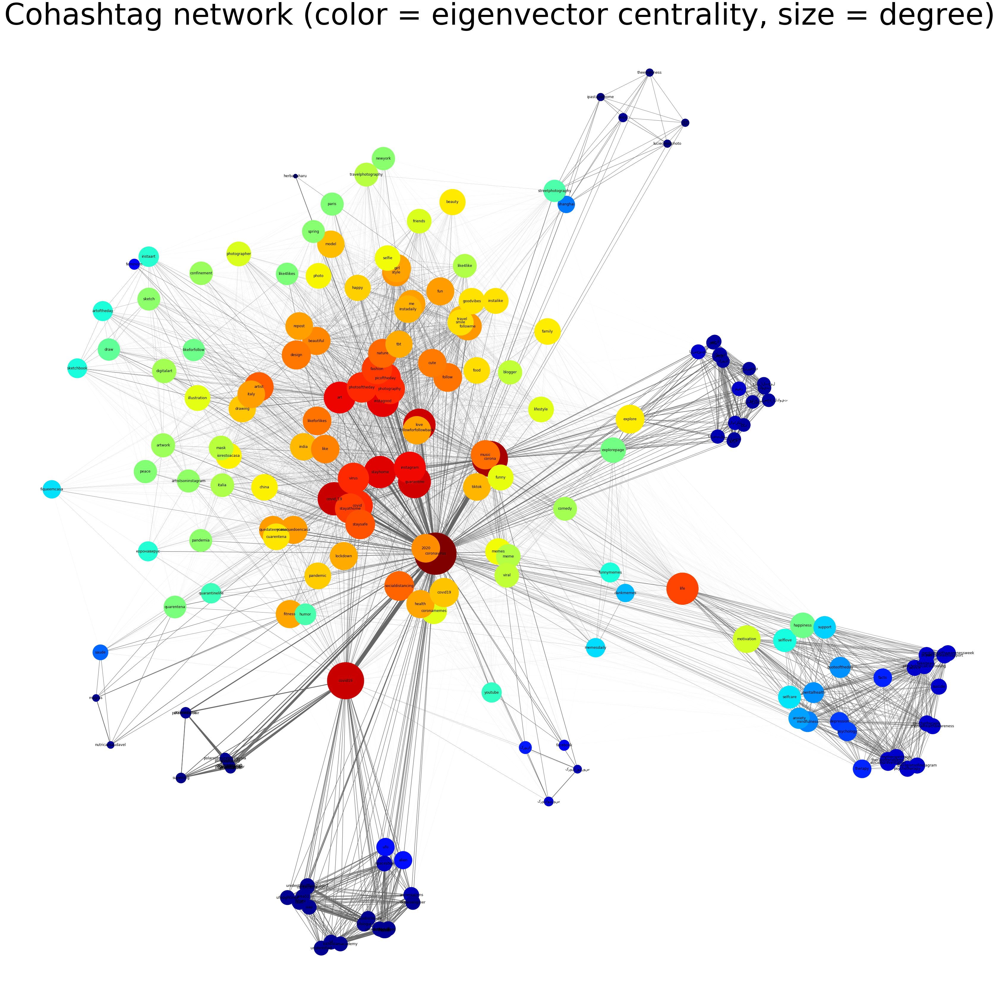

In [13]:
#plot the eigenvector centrality of all nodes in the network

#this function saves the plot to a file in your working directory
plot_centrality(G, 'Cohashtag','eigenvector', save = True)

In [14]:
#now we want to have access to this data later so we can load it into a python dictionary
eig_centrality = nx.eigenvector_centrality(G)

In [19]:
#exemple
print('The eigen vector centrality of hashtag "covid19" is: ', eig_centrality['covid19'])

The eigen vector centrality of hashtag "covid19" is:  0.12799650067592966


In [21]:
#we can also save it to csv file
save_dictionary(eig_centrality, 'eigenvector_centrality_unsorted.csv')

<p>Now we can do a quick bar plot to observe the values. We should also note that the hashtags appear is in decreasing order of frequency with respect to the dataset. Therefore, it is interesting to see that the values are not strictly decreasing as certain have very low connectivity even though they appear frequently in the dataset. This indicates the presence of clusters of topics of interest to the public<p>

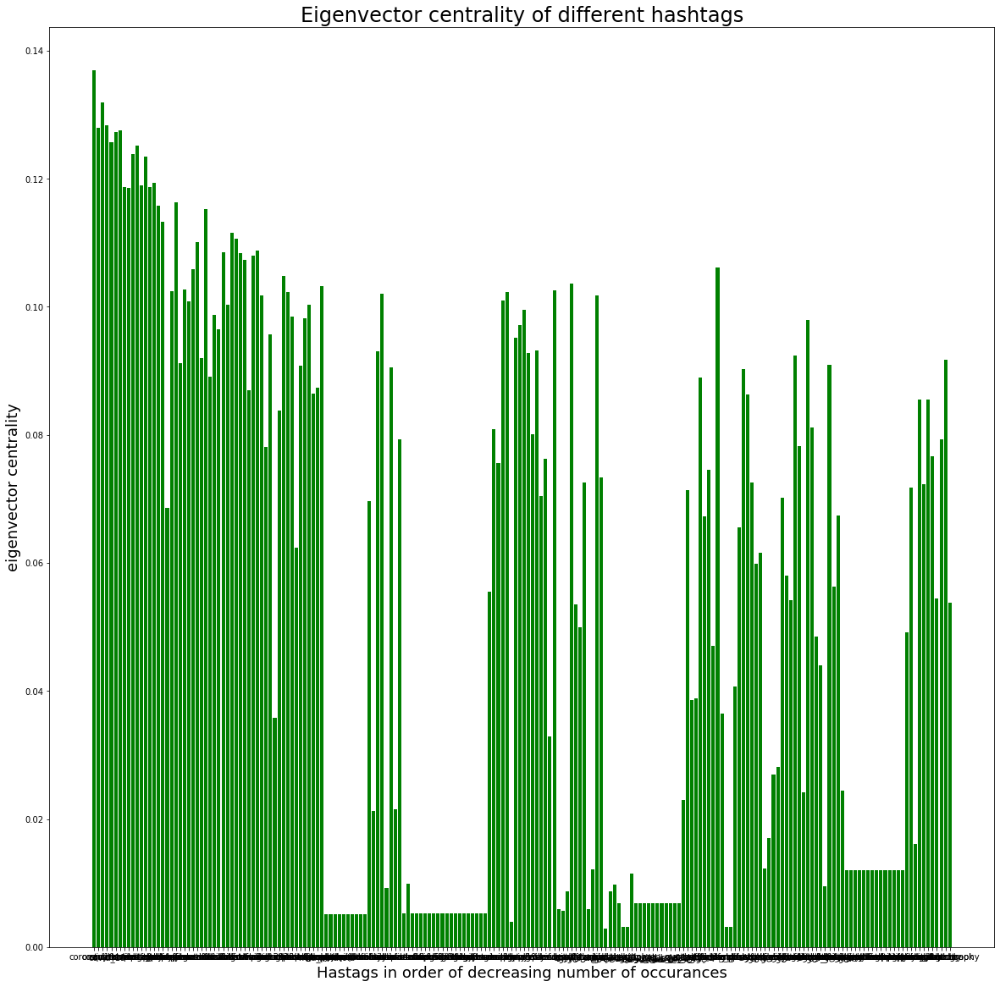

In [31]:
#quick plot
dictionary_quick_plot(eig_centrality, title = 'Eigenvector centrality of different hashtags', xaxis = "Hastags in order of decreasing number of occurances", yaxis = "eigenvector centrality")

<p><b>Clustering coefficient:</b> Another coefficient often cited in the litterature is the clustering coefficent, which characterizes by how much the node is in a cluster. More formally it is defined as follows.<p>

<p>$C_k = \frac{1}{deg(k)(deg(k)-1)}\sum_{uv}(w_{ku}\times w_{uv}\times w_{kv})^{\frac{1}{3}}$<p>

<p>The intuition behind this formula is that we sum up all of the geometric averages of the weights formed by triangular subgraphs formed by node k and 2 of its neighbours (u and v). When there is no edge between u and v,  this geometric average is 0 since one of the edges is zero. We then divide by the maximum number of possible edges<p>

<p><b>Usefulness for cohashtag networks:</b> For cohashtag networks, this is quantifies by how much these hashtags are outisde of the mainstream covid instagram trends. While not perfect since it flags outliers in the dataset. It still provides a useful single value metric to identify the interesting conversations outside the mainstream #beauty trends<p>

In [198]:
#it is computed in python networkx with a single line of code
clustering_coefficient = nx.clustering(G)

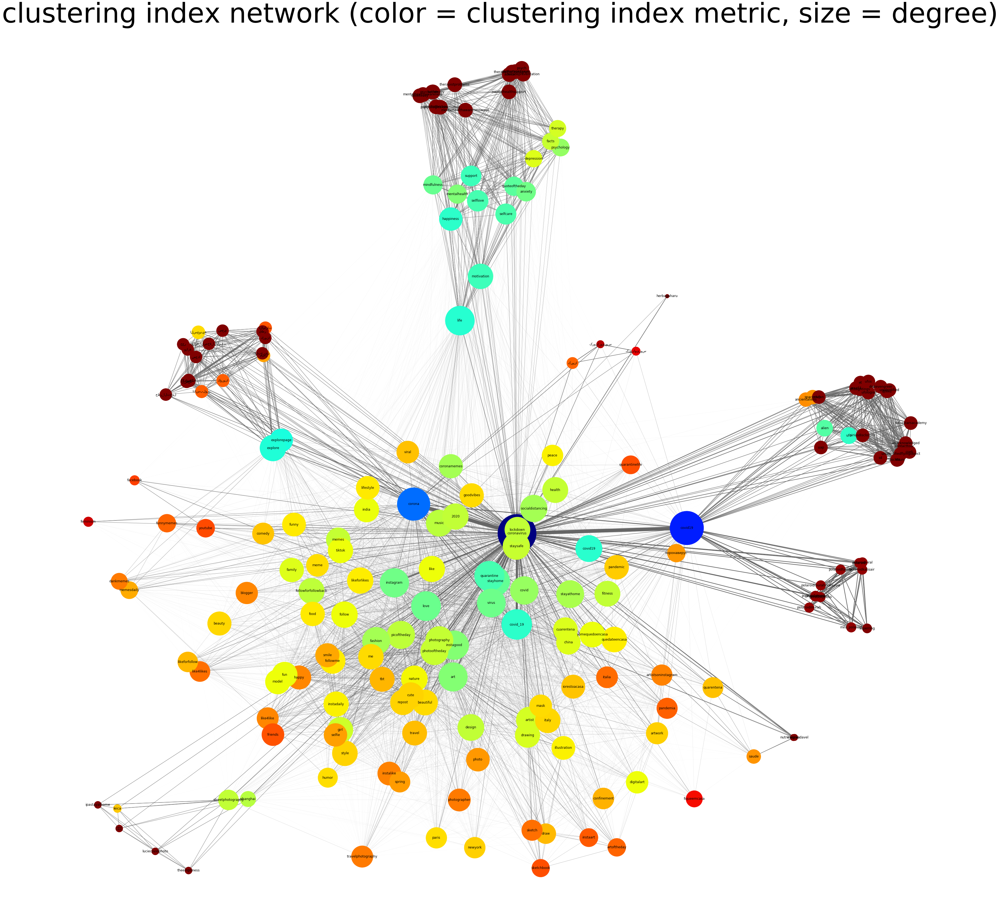

In [201]:
#use helper function to plot
plot_novel_metric(G, 'clustering index', clustering_coefficient, save = True)

<p><b>2) Clustering</b><p>

<p>We are now interested in clustering these topics into different communities of hashtags. In this context a community could represent specific discussions (like mental health, ufos) or cultural cluster where people with similar backgrounds will have similar references (a specific language for exemple). Indeed, we should remember that our graph represents how often people associate two hashtags together. The strength of clustering relies on the fact that communities are grouped together based on the structure of the social network and thus allow analysts to characterize the structure of the dataset. For our specific exemple, this will allow us to narrow down our analysis on certain regions of interest.<p>
    
<p>For this project we use the Girvan Newman algorithm to group hashtags into communities. This algorithm relies on seperating communities based on the edges that are most often walked across when finding the shortest paths between 2 nodes in the graph<p>

<p><b>Overfitting/underfitting:</b> For clustering, certain partions are better than others. The metric that we use for determining wether of not our clustering is overfitting/underfitting the data is weighted density (do not worry about the overfitting metric number that is printed by the overfitting_metric, in the end the simple weighted density proved more useful for the analysis). The weighted density is defined as follows:<p>
<p>$w = \frac{1}{ \left | V \right |}\sum_{C \in Communities} \left | C \right | \times density(c)$<p>
    
<p>where $\left | V \right |$ is the total number of nodes whereas $\left | C \right |$ is the number of nodes of each community. Essentially, the contribution of the density of each community is proportional to the number of nodes present in that community. <p>
    
<p>If the weighted density is very low and increasing rapidly with the an increasing number of communities, then our partition is  underfitting. Inversely, if our weighted is rather high and stays relatively constant as the number of communities increases, then our partition is overfitting.<p>
    
<p><b>Note:</b> The density of a graph is defined as the ratio of the number of edges over the maximum number of edges in this graph. If we are talking about an undirected graph without self loops, the maximum number of edges is if there is one edge between every single node, which is $\binom{n}{2} = \frac{n!}{2!\times(n-2)!} = \frac{n(n-1)}{2}$. And the density of a graph is thus $D = \frac{2\left | E \right |}{n(n-1)}$<p>



In [81]:
#notice that this function does not take a graph as input but rather the adjacency matrix
avg_densities, communities = overfitting_metric(20, adj)



The number of communities chosen is 2
The weighted density is0.2762121212121212
The overfitting metric is0.995338734263749


The number of communities chosen is 3
The weighted density is0.30696891191709846
The overfitting metric is0.8956106382193693


The number of communities chosen is 4
The weighted density is0.37423076923076926
The overfitting metric is0.734639280678831


The number of communities chosen is 5
The weighted density is0.5110377358490565
The overfitting metric is0.5379732333441252


The number of communities chosen is 6
The weighted density is0.5126582278481012
The overfitting metric is0.5362727216328558


The number of communities chosen is 7
The weighted density is0.5143630573248408
The overfitting metric is0.5344952737186023


The number of communities chosen is 8
The weighted density is0.6226428571428572
The overfitting metric is0.44154465109763574


The number of communities chosen is 9
The weighted density is0.6245323741007194
The overfitting metric is0.44020876

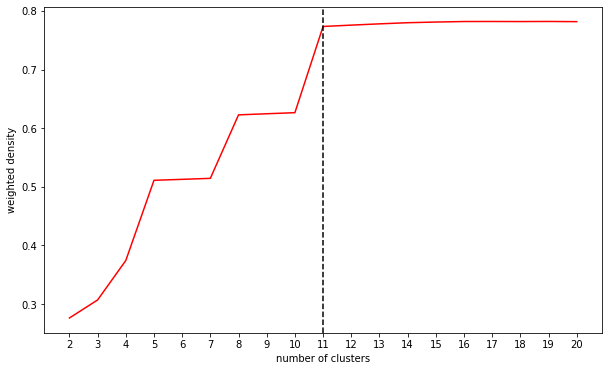

In [85]:
#we then plot our weighted densities in order to determine the best possible partition
#the arguments of this function are the 
plotWD(avg_densities, 20, 11)

<p>We can see that as we increase the number of comunities beyond 11 in this case the weighted density stops increasing significantly. Therefore, we choose 11 as the best number of possible clusters possible.<p>
    
<p>We thus compute these ideal 11 clusters in the next step and store them in a python dictionary. We also store the densities, the number of nodes and the graph objects of each communities in lists.<p>

In [205]:
communities, densities_com, numnodes_com, graphs = community_clustering(11, adj, [sorted_hashtags, nx.clustering(G), nx.eigenvector_centrality(G)], ['mentions', 'clustering index', 'eigenvector centrality'])

The weighted density is 0.7734070796460177


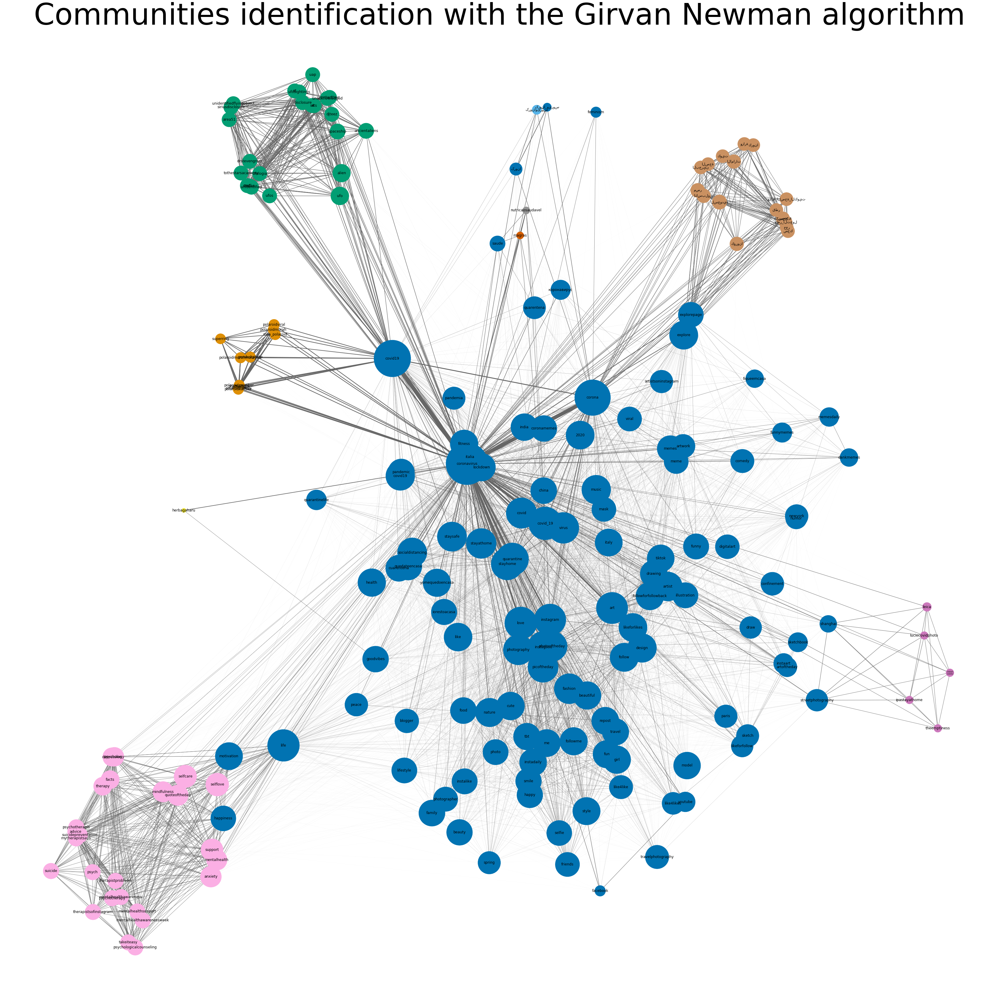

In [94]:
plot_communities(G, communities, save=True)

<p>We can see that our partition is visually good using the 'spring layout' of the plotting function. This is further indication that out analysis was correct.<p>
<p>Next we compute the average metrics for each of the communities to get further intuition<p>

In [203]:
communities_data = analyse_communities(graphs, ['mentions', 'clustering index', 'eigenvector centrality'])



------------------------------------- Community 1 -------------------------------------

BASIC INFO:
Name: 
Type: Graph
Number of nodes: 114
Number of edges: 4163
Average degree:  73.0351
Density:  0.6463282099052942


FIRST FEW WORDS:
['2020', 'art', 'artist', 'artistsoninstagram', 'artoftheday', 'artwork', 'beautiful', 'beauty', 'blogger', 'china']

ADVANCED PROPERTIES:
Average mentions:  164.71052631578948
Average clustering index:  0.7376502597139033
Average eigenvector centrality:  0.08922061055982211


------------------------------------- Community 2 -------------------------------------

BASIC INFO:
Name: 
Type: Graph
Number of nodes: 11
Number of edges: 55
Average degree:  10.0000
Density:  1.0


FIRST FEW WORDS:
['gerobokphoto', 'mila_polaroid', 'photoalbum', 'polaroid', 'polaroidfamily', 'polaroidkalisair', 'polaroidmember', 'polaroidmurah', 'polaroidmurahmalaysia', 'polaroidviral']

ADVANCED PROPERTIES:
Average mentions:  148.45454545454547
Average clustering index:  0.98

<p><b>3) Save the interesting data to .csv and .json files</b><p>

In [197]:
#saving the file to a .csv file for excel
df = pd.DataFrame(np.zeros(shape=(len(communities_data['Community 1']),len(communities_data))), columns = communities_data.keys(), index = communities_data['Community 1'].keys())

for cm in list(communities_data.keys()):
    for metric in list(communities_data['Community 1'].keys()):
        df[cm][metric] = communities_data[cm][metric]

NAME = 'communities metric comparaisons'
df.to_csv(NAME)
df

,Community 1,Community 2,Community 3,Community 4,Community 5,Community 6,Community 7,Community 8,Community 9,Community 10,Community 11
mentions,164.710526,148.454545,84.521739,141.000000,65.200000,67.588235,55.680000,135.000000,124.000000,110.000000,167.000000
clustering index,0.737650,0.988345,0.948065,1.000000,0.955556,0.950795,0.840702,1.000000,1.000000,0.933333,0.964286
eigenvector centrality,0.089221,0.005010,0.007020,0.005895,0.003617,0.007848,0.023093,0.005895,0.002854,0.012278,0.009528
Density,0.646328,1.000000,1.000000,0.000000,1.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000


In [218]:
#create a dictionary of communities
community_dict = {}
k = 0
for com in list(communities_data.keys()):
    community_dict[com] = list(communities[k])
    k += 1
       

In [223]:
#saving communities to a .json file
with open('communities.json', 'w') as outfile:
    json.dump(community_dict, outfile)


In [225]:
#saving eigenvector centralities to a .csv file
save_dictionary(nx.eigenvector_centrality(G), 'eigenvector_centrality.csv')

#saving clustering centralities to a .csv file
save_dictionary(nx.clustering(G), 'clustering_coefficients.csv')